In [26]:
import os
import glob
from PIL import Image
from tqdm import tqdm

In [2]:
from rembg.bg import remove
import numpy as np
import io
import cv2

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as img
import re

In [4]:
files = glob.glob('muct_github/dataset_muct/*.jpg')
files.sort()

In [5]:
print(f'ファイル数：{len(files)}')

ファイル数：3755


# 背景削除する

In [6]:
OUTPUT_DIR = 'original_muct_rembg/'
!mkdir -p $OUTPUT_DIR

In [7]:
ls ../../../colors/

black.png  bluepurple.png  purple.png  white.png   yellowred.png
blue.png   green.png       red.png     yellow.png


In [8]:
bg = Image.open('../../../colors/white.png').convert('RGBA')  # 背景の読み込み
bg = bg.resize((480, 640)) # muctのサイズに合わせる

for f in tqdm(files):
    img = Image.open(f)
    img_bytes = io.BytesIO()
    img.save(img_bytes, format='PNG')
    img_bytes = img_bytes.getvalue()
    
    rem_img = remove(img_bytes)
    img = Image.open(io.BytesIO(rem_img)).convert("RGBA")
    
    # 画像合成
    img_clear = Image.new("RGBA", bg.size, (255, 255, 255, 0))
    img_clear.paste(img)
    result = Image.alpha_composite(bg, img_clear)
    
    root, ext = os.path.splitext(f)
    basename = os.path.basename(root)
    
    result.save(os.path.join(OUTPUT_DIR, f'{basename}.png'),quality=100)

  0%|                                                                                                                                                                              | 0/3755 [00:00<?, ?it/s]/opt/conda/lib/python3.8/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3755/3755 [55:38<00:00,  1.12it/s]


In [9]:
resize_imgs = glob.glob(os.path.join(OUTPUT_DIR,'*.png'))
print(f'背景削除後の画像 : {len(resize_imgs)}枚')

背景削除後の画像 : 3755枚


In [10]:
import matplotlib.pyplot as plt

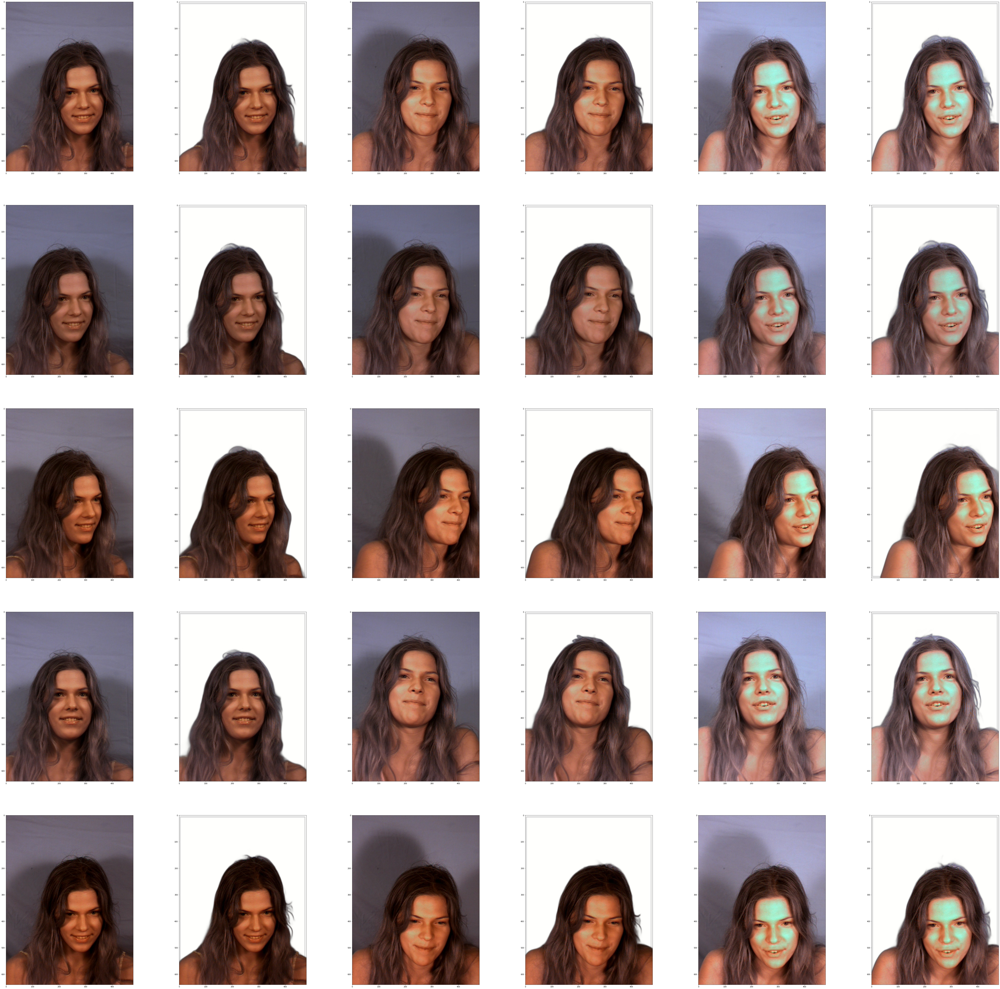

In [11]:
files.sort()
resize_imgs.sort()

threshold = 30

col = 6
row = 5

plt.figure(figsize=(100,100))
for i, pos in enumerate(range(0, col*row, col)):
    plt.subplot(row, col, pos+1)
    color = cv2.imread(files[i] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+2)
    color = cv2.imread(resize_imgs[i] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+3)
    color = cv2.imread(files[i+row] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+4)
    color = cv2.imread(resize_imgs[i+row] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+5)
    color = cv2.imread(files[i+row*2] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+6)
    color = cv2.imread(resize_imgs[i+row*2] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)

## 背景除去したoriginalのmuctをcrop

In [12]:
files = glob.glob('original_muct_rembg/*.png')
files.sort()
files[:5]

['original_muct_rembg/i000qa-fn.png',
 'original_muct_rembg/i000qb-fn.png',
 'original_muct_rembg/i000qc-fn.png',
 'original_muct_rembg/i000qd-fn.png',
 'original_muct_rembg/i000qe-fn.png']

In [13]:
df = pd.read_csv('muct_github/muct76-opencv.csv')
df.sort_values('name')
df.head()

,name,tag,x00,y00,x01,y01,x02,y02,x03,y03,...,x71,y71,x72,y72,x73,y73,x74,y74,x75,y75
0,i000qa-fn,0,201,348,201.0,381.0,202.0,408.0,209,435.0,...,235.5,348.5,338.0,333.5,324.0,335.5,326.0,342.5,340.0,340.5
1,i000qb-fn,0,162,357,157.0,387.0,160.0,418.0,167,446.0,...,202.5,359.0,305.5,346.0,291.5,348.0,292.0,354.5,306.0,352.5
2,i000qc-fn,0,212,352,203.0,380.0,200.0,407.0,211,439.0,...,257.5,355.0,344.5,343.5,334.0,345.0,335.0,351.0,345.5,349.5
3,i000qd-fn,0,157,316,155.0,348.0,154.0,373.0,159,407.0,...,192.0,319.0,295.5,311.5,280.0,313.0,282.0,320.0,297.5,318.5
4,i000qe-fn,0,201,373,200.0,408.0,203.0,433.0,213,463.0,...,237.0,377.5,335.5,366.5,322.0,369.0,324.5,375.0,338.0,372.5


In [14]:
print(f'ファイル数：{len(files)}')

ファイル数：3755


In [15]:
OUTPUT_DIR = 'muct_rembg_resized_256/'
!mkdir -p $OUTPUT_DIR

In [16]:
muct_name = df['name'].values.tolist()
muct_name.sort()

df = df.replace([0], np.nan)
df['x_min'] = df.filter(like='x',axis=1).min(axis=1)
df['x_max'] = df.filter(like='x',axis=1).max(axis=1)
df['y_min'] = df.filter(like='y',axis=1).min(axis=1)
df['y_max'] = df.filter(like='y',axis=1).max(axis=1)

muct_list = sorted(files)

In [17]:
def crop_roi(landmark_roi,margins = [0.8,0.05]):
    base_length = landmark_roi.y_max - landmark_roi.y_min    
    top = int(landmark_roi.y_min - base_length*margins[0])
    bottom = int(landmark_roi.y_max + base_length*margins[1])
    width = bottom - top
    center_x = (landmark_roi.x_max + landmark_roi.x_min) // 2
    left = center_x - width // 2
    right = center_x + width // 2
    
    return (left,top,right,bottom)

In [18]:
# # 背景として使う白色画像を作成 
# height = 256
# width = 256
# blank = np.zeros((height, width, 3))
# blank += 255 #←全ゼロデータに255を足してホワイトにする
 
# cv2.imwrite('white.png',blank)

In [19]:
bg = Image.open('../../../colors/white.png').convert('RGBA')  # cropして生じる余白を白で埋めるための背景画像

for i , (path , col) in tqdm(enumerate(zip(muct_list,df.itertuples()))):
    img = Image.open(path)    
    # box=(left, upper, right, lower)
    img_crop = img.crop(crop_roi(col))
    img_resize = img_crop.resize((256, 256))
    
    # 画像合成
    img_clear = Image.new("RGBA", bg.size, (255, 255, 255, 0))
    img_clear.paste(img_resize)
    result = Image.alpha_composite(bg, img_clear)
    
    root, ext = os.path.splitext(path)
    basename = os.path.basename(root)
    
    result.save(os.path.join(OUTPUT_DIR, f'{basename}.png'),quality=100)

3755it [05:07, 12.20it/s]


In [20]:
resize_imgs = glob.glob(os.path.join(OUTPUT_DIR,'*.png'))
print(f'リサイズ後の画像 : {len(resize_imgs)}枚')

リサイズ後の画像 : 3755枚


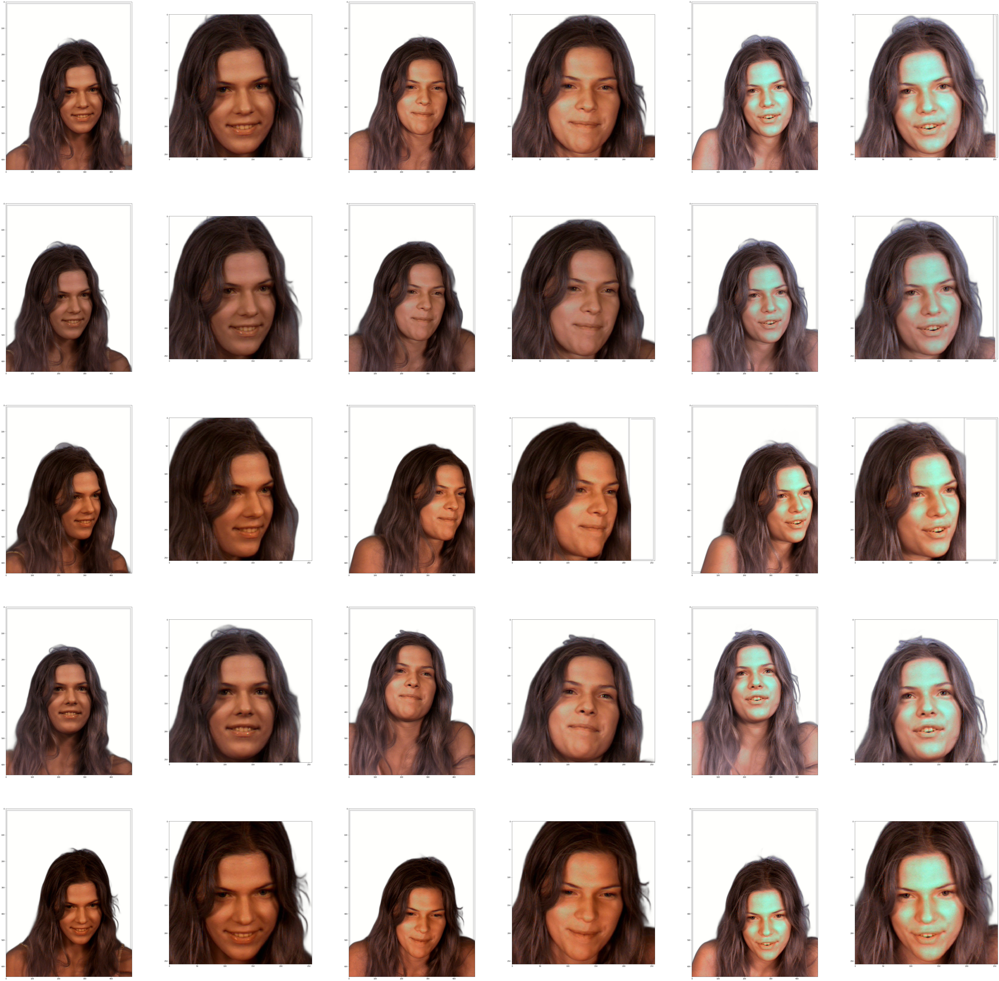

In [21]:
files.sort()
resize_imgs.sort()

threshold = 30

col = 6
row = 5

plt.figure(figsize=(100,100))
for i, pos in enumerate(range(0, col*row, col)):
    plt.subplot(row, col, pos+1)
    color = cv2.imread(files[i] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+2)
    color = cv2.imread(resize_imgs[i] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+3)
    color = cv2.imread(files[i+row] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+4)
    color = cv2.imread(resize_imgs[i+row] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+5)
    color = cv2.imread(files[i+row*2] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)
    
    plt.subplot(row, col, pos+6)
    color = cv2.imread(resize_imgs[i+row*2] , 1) 
    color_rgb = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
    plt.imshow(color_rgb)

# カメラと向きをraに固定する

In [22]:
import cv2
import glob
import numpy as np
from PIL import Image
from natsort import natsorted
from matplotlib import pyplot as plt

In [23]:
a = glob.glob('muct_rembg_resized_256/*.png')

In [27]:
file_ra = [s for s in a if 'ra' in s]

In [29]:
file_ra[:5]

['muct_rembg_resized_256/i077ra-fn.png',
 'muct_rembg_resized_256/i014ra-fn.png',
 'muct_rembg_resized_256/i006ra-mn.png',
 'muct_rembg_resized_256/i009ra-mn.png',
 'muct_rembg_resized_256/i025ra-mn.png']

In [30]:
len(file_ra)

91

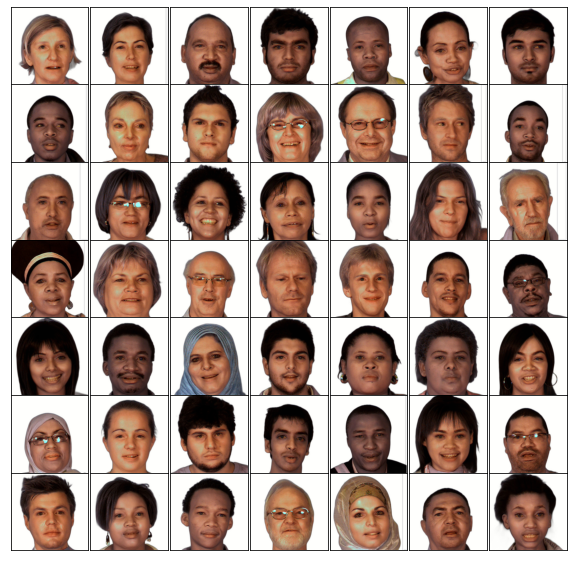

In [31]:
# filesに何を入れるか？
files = file_ra

# タイル状に pm × pm 枚配置
pm = 7
d = []
for i in files:
    img = Image.open(i)
    img = np.asarray(img)
    d.append(img)
# タイル状に画像を一覧表示
fig, ax = plt.subplots(pm, pm, figsize=(10, 10))
fig.subplots_adjust(hspace=0, wspace=0)
for i in range(pm):
    for j in range(pm):
        ax[i, j].xaxis.set_major_locator(plt.NullLocator())
        ax[i, j].yaxis.set_major_locator(plt.NullLocator())
        ax[i, j].imshow(d[pm*i+j], cmap="bone")
plt.show()

In [32]:
os.mkdir('muct_rembg_resized_ra')

In [34]:
import shutil

In [35]:
for i in file_ra:
    shutil.copy(i, 'muct_rembg_resized_ra/')

In [37]:
glob.glob('muct_rembg_resized_ra/*.png')

['muct_rembg_resized_ra/i077ra-fn.png',
 'muct_rembg_resized_ra/i014ra-fn.png',
 'muct_rembg_resized_ra/i006ra-mn.png',
 'muct_rembg_resized_ra/i009ra-mn.png',
 'muct_rembg_resized_ra/i025ra-mn.png',
 'muct_rembg_resized_ra/i063ra-fn.png',
 'muct_rembg_resized_ra/i010ra-mn.png',
 'muct_rembg_resized_ra/i040ra-mn.png',
 'muct_rembg_resized_ra/i019ra-fn.png',
 'muct_rembg_resized_ra/i089ra-mn.png',
 'muct_rembg_resized_ra/i053ra-fg.png',
 'muct_rembg_resized_ra/i054ra-mg.png',
 'muct_rembg_resized_ra/i002ra-mn.png',
 'muct_rembg_resized_ra/i038ra-mn.png',
 'muct_rembg_resized_ra/i049ra-mn.png',
 'muct_rembg_resized_ra/i029ra-fg.png',
 'muct_rembg_resized_ra/i080ra-fn.png',
 'muct_rembg_resized_ra/i065ra-fn.png',
 'muct_rembg_resized_ra/i026ra-fn.png',
 'muct_rembg_resized_ra/i000ra-fn.png',
 'muct_rembg_resized_ra/i075ra-mn.png',
 'muct_rembg_resized_ra/i005ra-fn.png',
 'muct_rembg_resized_ra/i021ra-fn.png',
 'muct_rembg_resized_ra/i073ra-mg.png',
 'muct_rembg_resized_ra/i045ra-mn.png',
